<a href="https://colab.research.google.com/github/DUNGTK2004/Vietnam-license-plate-recognition/blob/main/New_data_exploration.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

### Load data from roboflow

In [54]:
!pip install roboflow

from roboflow import Roboflow
rf = Roboflow(api_key="46Ilnz16zaA8LuxJQtVc")
project = rf.workspace("dungcv").project("lpr-q3vyf-vuqru")
version = project.version(1)
dataset = version.download("yolov9")


### Load paddle OCR model

In [55]:
!pip install paddlepaddle-gpu paddleocr

In [3]:
import numpy as np
import os
import csv
import glob
from matplotlib import pyplot as plt
from paddleocr import PaddleOCR, draw_ocr

You are using GPU version Paddle, but your CUDA device is not set properly. CPU device will be used by default.


In [4]:
# Without fine-tuning text recognition
ocr = PaddleOCR(lang="en", show_log=False)

download https://paddleocr.bj.bcebos.com/PP-OCRv3/english/en_PP-OCRv3_det_infer.tar to /root/.paddleocr/whl/det/en/en_PP-OCRv3_det_infer/en_PP-OCRv3_det_infer.tar


100%|██████████| 3910/3910 [00:16<00:00, 233.32it/s] 


download https://paddleocr.bj.bcebos.com/PP-OCRv4/english/en_PP-OCRv4_rec_infer.tar to /root/.paddleocr/whl/rec/en/en_PP-OCRv4_rec_infer/en_PP-OCRv4_rec_infer.tar


100%|██████████| 10000/10000 [00:19<00:00, 500.07it/s]


download https://paddleocr.bj.bcebos.com/dygraph_v2.0/ch/ch_ppocr_mobile_v2.0_cls_infer.tar to /root/.paddleocr/whl/cls/ch_ppocr_mobile_v2.0_cls_infer/ch_ppocr_mobile_v2.0_cls_infer.tar


100%|██████████| 2138/2138 [00:16<00:00, 127.45it/s]


### Function to predict image from image

In [56]:
import time

def paddle_predict(img_path, ocr):
    """
    Dự đoán văn bản từ ảnh bằng PaddleOCR và hiển thị kết quả trên ảnh.

    Args:
        img_path (str): Đường dẫn tới ảnh cần nhận diện.
        ocr (object): Đối tượng OCR đã khởi tạo từ PaddleOCR.

    Returns:
        text: Văn bản nhận diện được
    """
    # Đọc và hiển thị ảnh
    image = plt.imread(img_path)
    plt.imshow(image)

    # Bắt đầu tính thời gian
    start_time = time.time()

    # Dự đoán văn bản
    result = ocr.ocr(img_path)
    processing_time = time.time() - start_time
    print(f"Processing time: {processing_time:.2f} seconds")

    # Ghép các đoạn văn bản lại thành chuỗi hoàn chỉnh
    final_text = "".join([line[1][0] for line in result[0]])

    # Hiển thị kết quả lên ảnh
    plt.text(
        x=400,
        y=image.shape[0] / 2,
        s=final_text,
        fontsize=20,
        color='red',
        ha='center',
        va='center'
    )
    plt.show()

    return final_text


In [6]:
import os
#List names of images
dir_path = "/content/LPR-1/valid/images/"
list_dir = os.listdir(dir_path)
files = [file for file in list_dir]

print(files[0])

20240117_102323_jpg.rf.81e33881f0b664f58e57d96fd450a9ab.jpg


### Fine-tuning YOLOv10 on the License plate detection dataset

[Link colab fine-tuning YOLOv10](https://colab.research.google.com/drive/1HpTjrDaupzhtmczWazmJGI8V1bpnKmIq?usp=sharing)

[Link model fine-tuned](https://drive.google.com/file/d/1CgzHCranp5t-WlAVvMvRXOEl4DOs0LOg/view?usp=sharing)

## Application

In [57]:
!pip install ultralytics

In [11]:
from ultralytics import YOLO
model = YOLO("yolov10_license_recognition.pt")

Creating new Ultralytics Settings v0.0.6 file ✅ 
View Ultralytics Settings with 'yolo settings' or at '/root/.config/Ultralytics/settings.json'
Update Settings with 'yolo settings key=value', i.e. 'yolo settings runs_dir=path/to/dir'. For help see https://docs.ultralytics.com/quickstart/#ultralytics-settings.


### Predict và tính accuracy bằng edit distance

In [13]:
!pip install python-Levenshtein

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 162.7/162.7 kB 7.4 MB/s eta 0:00:00


### Function to calculate accuracy

In [16]:
import Levenshtein as lev


def levenshtein_accuracy(pred, true):
    # Tính Levenshtein Distance
    distance = lev.distance(pred, true)
    # Độ dài chuỗi dài hơn
    max_len = max(len(pred), len(true))
    # Tính độ chính xác
    accuracy = 1 - (distance / max_len)
    return accuracy

### Load image file and label from test dataset

In [63]:
f = open("labels.txt", "r")
map = {}
for x in f:
  x = x.split(" ")
  if len(x) == 1:
    continue
  map[x[0]] = x[1].replace("\n", "")
print(map)

{'20240117_101051_jpg.rf.7bb526f4eaf4c2221001279b7d123b29.jpg': '68-S1239.29', '20240117_101057-1-_jpg.rf.9f07e5c489837dcc1e3db0431230f00b.jpg': '95-AA085.36', '20240117_101106_jpg.rf.69ead3eff2182b2d6656e64fdea23693.jpg': '95-B2124.55', '20240117_101119_jpg.rf.cc965022108fae4869987fd57f17a26d.jpg': '69-F1581.11', '20240117_101150_jpg.rf.cd381db323ae016cb594c88cd985b055.jpg': '65-K1572.56', '20240117_101206_jpg.rf.801fc69b23d4503505422aae83865318.jpg': '64-K1438.14', '20240117_101228_jpg.rf.e501dccf53b04d4e550c184c0ffb0832.jpg': '95-M16154', '20240117_101241_jpg.rf.c672f1f83b747abb85d592abc1264dd3.jpg': '65-P83570', '20240117_101333_jpg.rf.39091d78c4a3b2f990a22789839d1868.jpg': '94-AB071.97', '20240117_101344_jpg.rf.dd4c6132c5a9db272b9d45b7e6b7fc09.jpg': '62-D1074.89', '20240117_101346_jpg.rf.231fc70c218750033d07dbe78e8ee155.jpg': '66-LA103.33', '20240117_101408_jpg.rf.185bf3b66866cc57ca34d2a24e536215.jpg': '65-M1097.41', '20240117_101401-1-_jpg.rf.1095ac271e3e450893d2dfebad44608e.jpg'

### Predict on the test dataset and calculate accuracy of system

File name: 20240117_101051_jpg.rf.7bb526f4eaf4c2221001279b7d123b29.jpg

image 1/1 /content/LPR-1/valid/images/20240117_101051_jpg.rf.7bb526f4eaf4c2221001279b7d123b29.jpg: 480x640 1 Plate, 1052.8ms
Speed: 4.4ms preprocess, 1052.8ms inference, 0.4ms postprocess per image at shape (1, 3, 480, 640)
Time YOLO: 1.1664490699768066
Size: 1161 864
[2025/02/20 15:24:33] ppocr WARNING: Since the angle classifier is not initialized, it will not be used during the forward process
Processing time: 0.25 seconds


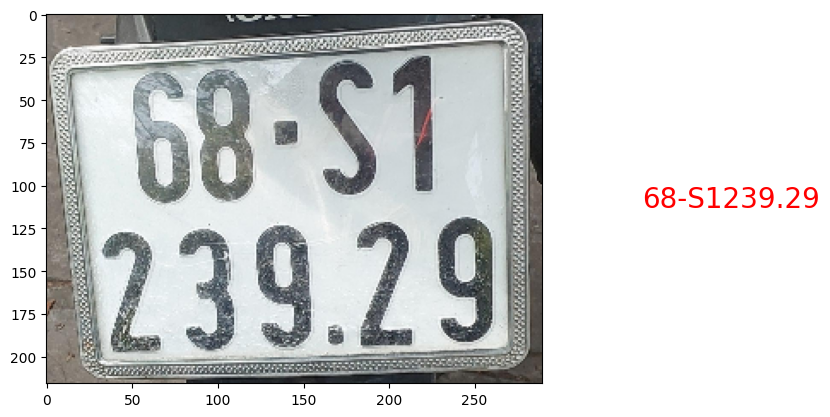

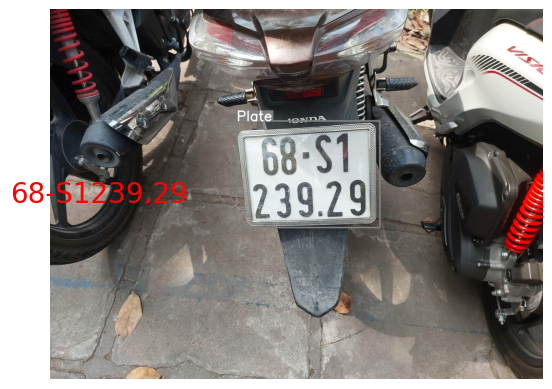

Time system: 3.3764467239379883
File name: 20240117_101057-1-_jpg.rf.9f07e5c489837dcc1e3db0431230f00b.jpg

image 1/1 /content/LPR-1/valid/images/20240117_101057-1-_jpg.rf.9f07e5c489837dcc1e3db0431230f00b.jpg: 384x640 1 Plate, 1161.4ms
Speed: 7.6ms preprocess, 1161.4ms inference, 0.4ms postprocess per image at shape (1, 3, 384, 640)
Time YOLO: 1.2503864765167236
Size: 720 478
[2025/02/20 15:24:36] ppocr WARNING: Since the angle classifier is not initialized, it will not be used during the forward process
Processing time: 0.18 seconds


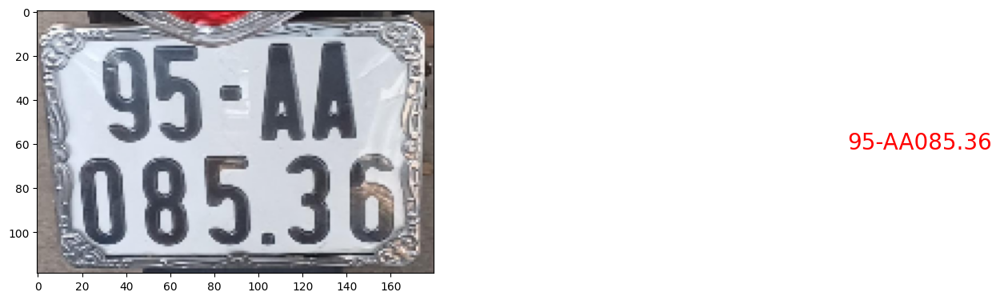

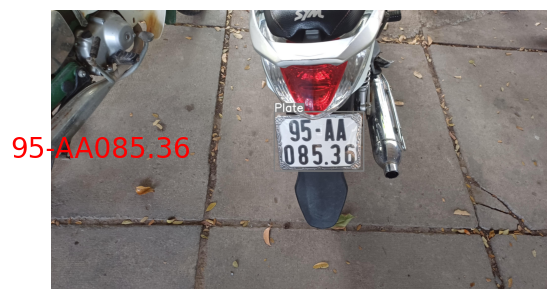

Time system: 2.3958582878112793
File name: 20240117_101106_jpg.rf.69ead3eff2182b2d6656e64fdea23693.jpg

image 1/1 /content/LPR-1/valid/images/20240117_101106_jpg.rf.69ead3eff2182b2d6656e64fdea23693.jpg: 480x640 1 Plate, 1009.9ms
Speed: 4.2ms preprocess, 1009.9ms inference, 0.3ms postprocess per image at shape (1, 3, 480, 640)
Time YOLO: 1.1285922527313232
Size: 1261 934
[2025/02/20 15:24:38] ppocr WARNING: Since the angle classifier is not initialized, it will not be used during the forward process
Processing time: 0.18 seconds


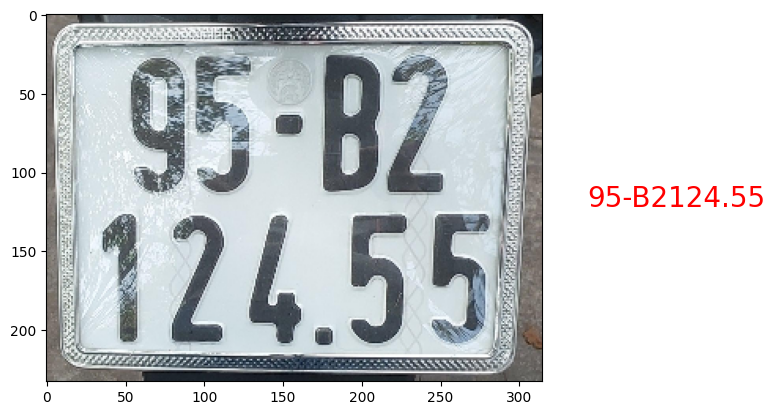

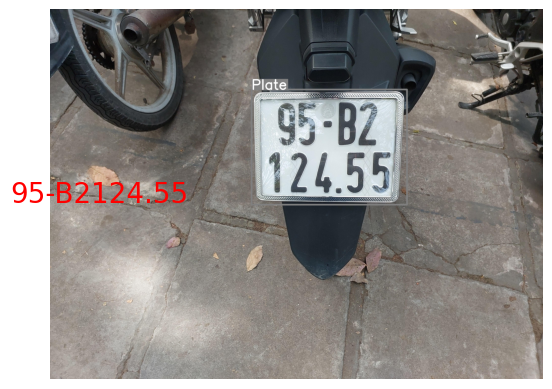

Time system: 2.5640246868133545
File name: 20240117_101119_jpg.rf.cc965022108fae4869987fd57f17a26d.jpg

image 1/1 /content/LPR-1/valid/images/20240117_101119_jpg.rf.cc965022108fae4869987fd57f17a26d.jpg: 480x640 1 Plate, 1022.6ms
Speed: 4.1ms preprocess, 1022.6ms inference, 0.4ms postprocess per image at shape (1, 3, 480, 640)
Time YOLO: 1.1563282012939453
Size: 1046 792
[2025/02/20 15:24:41] ppocr WARNING: Since the angle classifier is not initialized, it will not be used during the forward process
Processing time: 0.20 seconds


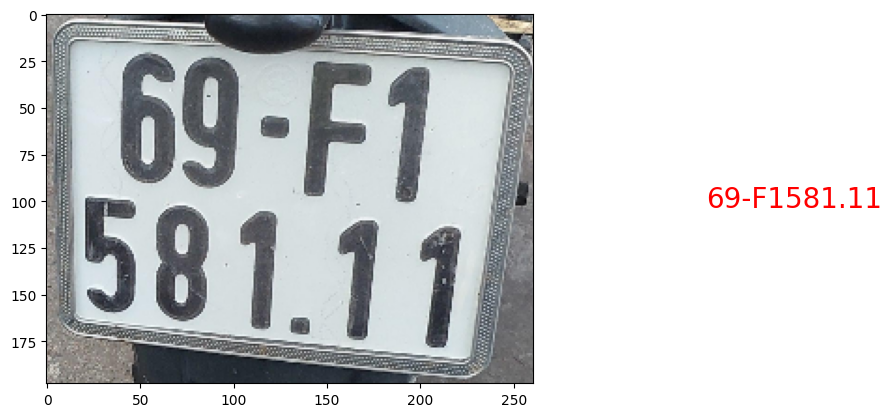

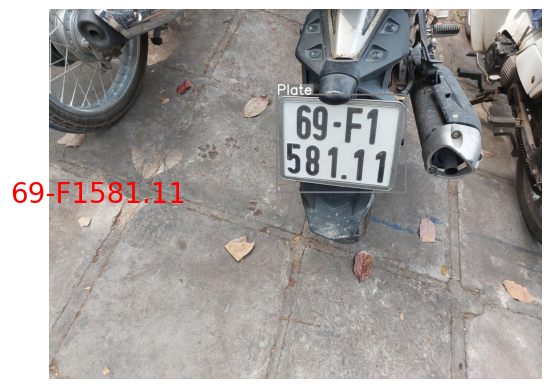

Time system: 2.5793778896331787
File name: 20240117_101150_jpg.rf.cd381db323ae016cb594c88cd985b055.jpg

image 1/1 /content/LPR-1/valid/images/20240117_101150_jpg.rf.cd381db323ae016cb594c88cd985b055.jpg: 480x640 1 Plate, 994.3ms
Speed: 4.1ms preprocess, 994.3ms inference, 0.4ms postprocess per image at shape (1, 3, 480, 640)
Time YOLO: 1.1104755401611328
Size: 1165 870
[2025/02/20 15:24:44] ppocr WARNING: Since the angle classifier is not initialized, it will not be used during the forward process
Processing time: 0.42 seconds


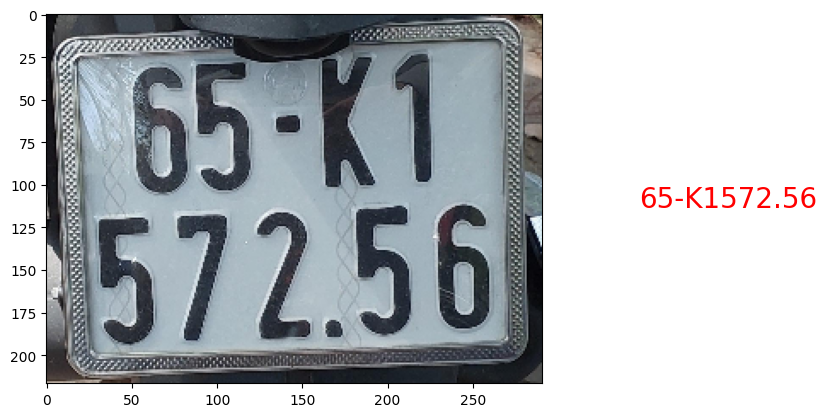

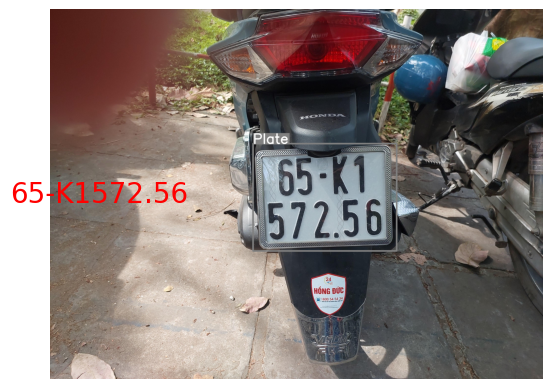

Time system: 2.7962779998779297
File name: 20240117_101206_jpg.rf.801fc69b23d4503505422aae83865318.jpg

image 1/1 /content/LPR-1/valid/images/20240117_101206_jpg.rf.801fc69b23d4503505422aae83865318.jpg: 480x640 1 Plate, 1567.6ms
Speed: 5.5ms preprocess, 1567.6ms inference, 0.4ms postprocess per image at shape (1, 3, 480, 640)
Time YOLO: 1.7040340900421143
Size: 1222 929
[2025/02/20 15:24:47] ppocr WARNING: Since the angle classifier is not initialized, it will not be used during the forward process
Processing time: 0.27 seconds


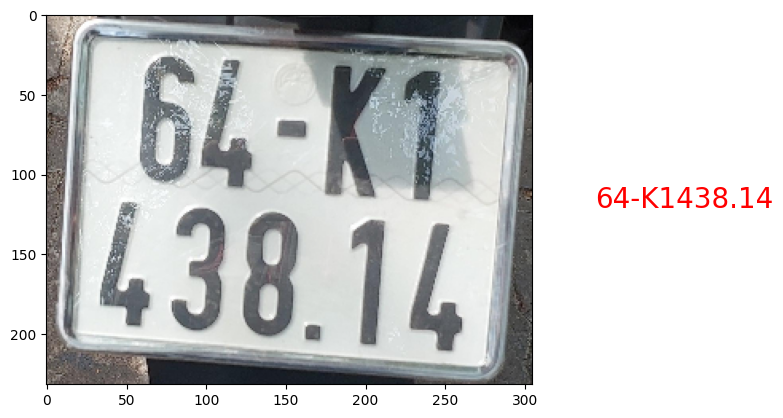

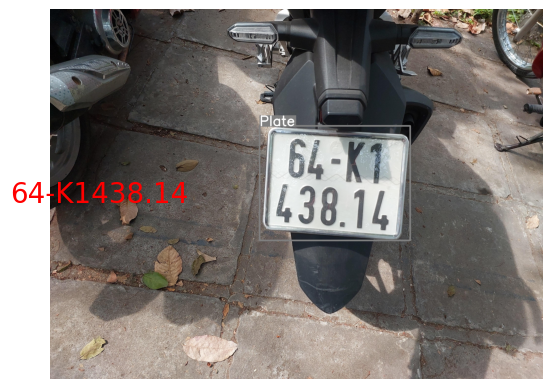

Time system: 3.6700942516326904
File name: 20240117_101228_jpg.rf.e501dccf53b04d4e550c184c0ffb0832.jpg

image 1/1 /content/LPR-1/valid/images/20240117_101228_jpg.rf.e501dccf53b04d4e550c184c0ffb0832.jpg: 480x640 1 Plate, 1070.3ms
Speed: 4.1ms preprocess, 1070.3ms inference, 0.4ms postprocess per image at shape (1, 3, 480, 640)
Time YOLO: 1.2162373065948486
Size: 1261 959
[2025/02/20 15:24:51] ppocr WARNING: Since the angle classifier is not initialized, it will not be used during the forward process
Processing time: 0.23 seconds


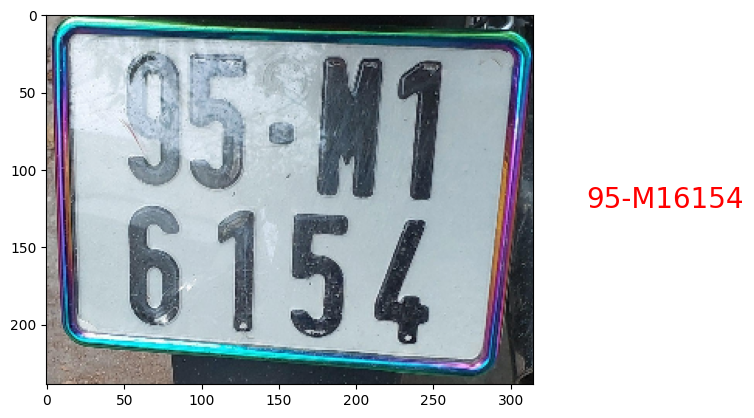

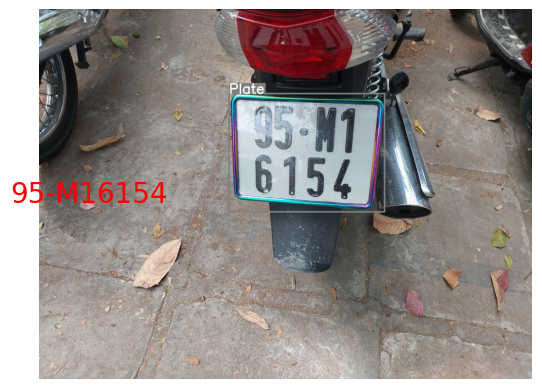

Time system: 2.7316904067993164
File name: 20240117_101241_jpg.rf.c672f1f83b747abb85d592abc1264dd3.jpg

image 1/1 /content/LPR-1/valid/images/20240117_101241_jpg.rf.c672f1f83b747abb85d592abc1264dd3.jpg: 480x640 1 Plate, 1003.6ms
Speed: 4.1ms preprocess, 1003.6ms inference, 0.4ms postprocess per image at shape (1, 3, 480, 640)
Time YOLO: 1.1479763984680176
Size: 981 765
[2025/02/20 15:24:53] ppocr WARNING: Since the angle classifier is not initialized, it will not be used during the forward process
Processing time: 0.24 seconds


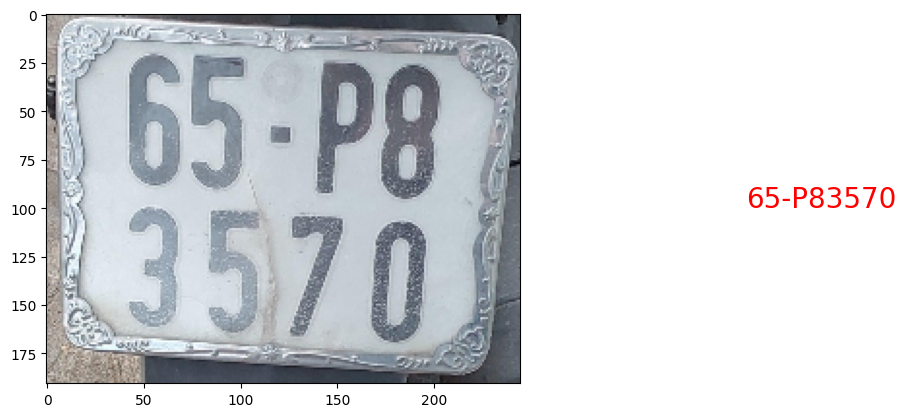

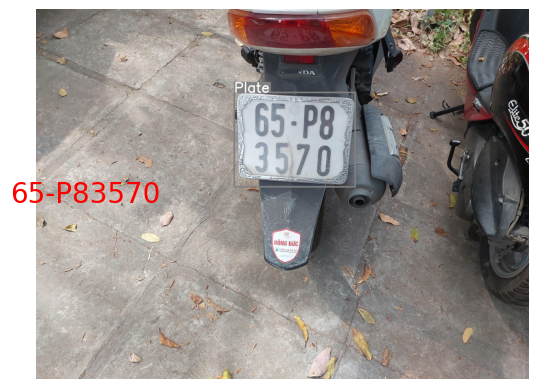

Time system: 2.7053470611572266
File name: 20240117_101333_jpg.rf.39091d78c4a3b2f990a22789839d1868.jpg

image 1/1 /content/LPR-1/valid/images/20240117_101333_jpg.rf.39091d78c4a3b2f990a22789839d1868.jpg: 384x640 1 Plate, 917.9ms
Speed: 4.8ms preprocess, 917.9ms inference, 0.4ms postprocess per image at shape (1, 3, 384, 640)
Time YOLO: 1.0071499347686768
Size: 743 534
[2025/02/20 15:24:56] ppocr WARNING: Since the angle classifier is not initialized, it will not be used during the forward process
Processing time: 0.27 seconds


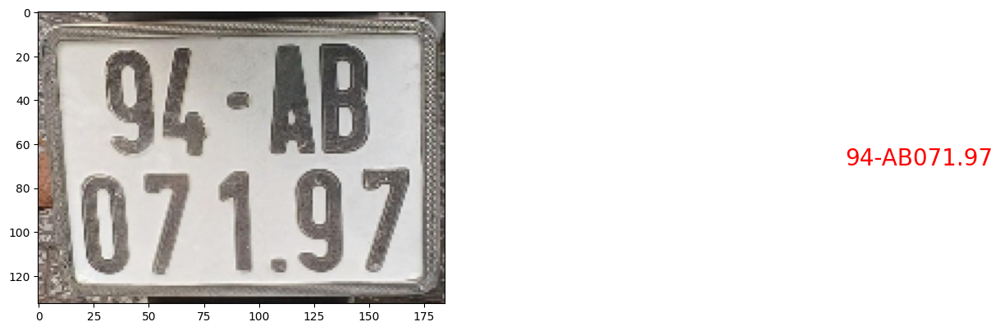

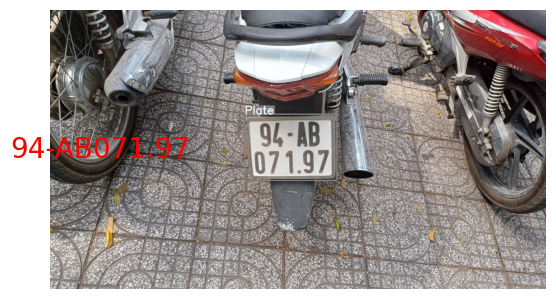

Time system: 2.3430287837982178
File name: 20240117_101344_jpg.rf.dd4c6132c5a9db272b9d45b7e6b7fc09.jpg

image 1/1 /content/LPR-1/valid/images/20240117_101344_jpg.rf.dd4c6132c5a9db272b9d45b7e6b7fc09.jpg: 384x640 1 Plate, 883.7ms
Speed: 5.2ms preprocess, 883.7ms inference, 0.3ms postprocess per image at shape (1, 3, 384, 640)
Time YOLO: 0.9686212539672852
Size: 886 669
[2025/02/20 15:24:58] ppocr WARNING: Since the angle classifier is not initialized, it will not be used during the forward process
Processing time: 0.25 seconds


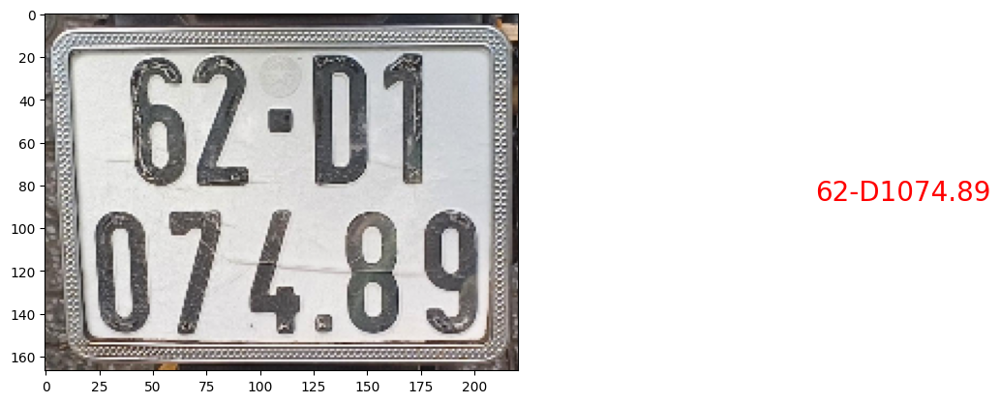

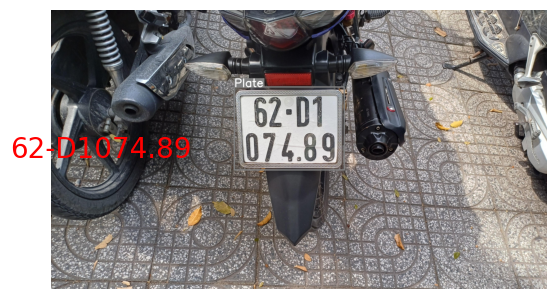

Time system: 2.7174072265625
File name: 20240117_101346_jpg.rf.231fc70c218750033d07dbe78e8ee155.jpg

image 1/1 /content/LPR-1/valid/images/20240117_101346_jpg.rf.231fc70c218750033d07dbe78e8ee155.jpg: 480x640 1 Plate, 1607.4ms
Speed: 6.1ms preprocess, 1607.4ms inference, 0.5ms postprocess per image at shape (1, 3, 480, 640)
Time YOLO: 1.7606546878814697
Size: 977 758
[2025/02/20 15:25:02] ppocr WARNING: Since the angle classifier is not initialized, it will not be used during the forward process
Processing time: 0.33 seconds


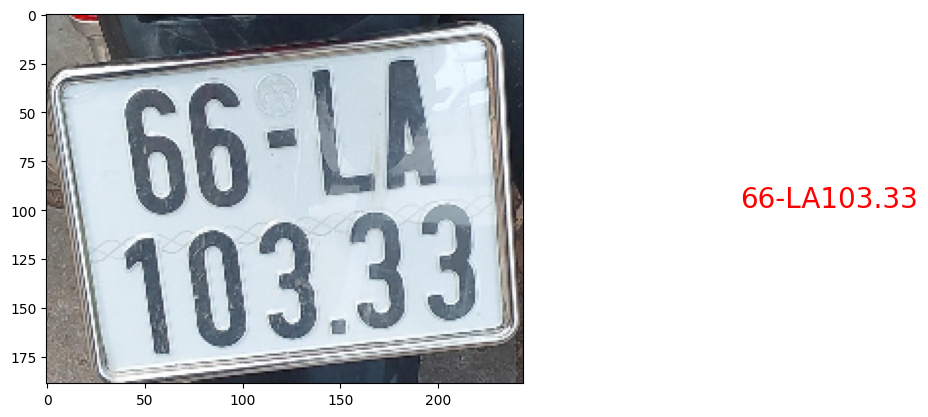

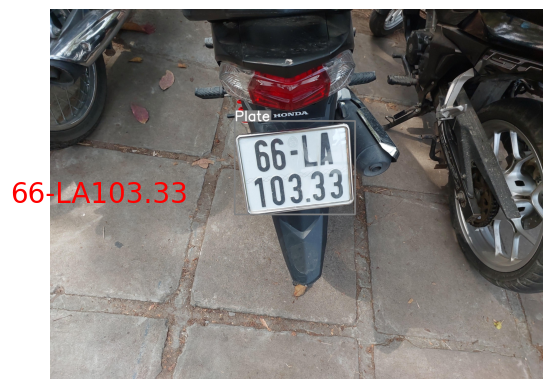

Time system: 3.526895761489868
File name: 20240117_101408_jpg.rf.185bf3b66866cc57ca34d2a24e536215.jpg

image 1/1 /content/LPR-1/valid/images/20240117_101408_jpg.rf.185bf3b66866cc57ca34d2a24e536215.jpg: 480x640 1 Plate, 1214.1ms
Speed: 6.3ms preprocess, 1214.1ms inference, 0.4ms postprocess per image at shape (1, 3, 480, 640)
Time YOLO: 1.3728153705596924
Size: 993 747
[2025/02/20 15:25:05] ppocr WARNING: Since the angle classifier is not initialized, it will not be used during the forward process
Processing time: 0.30 seconds


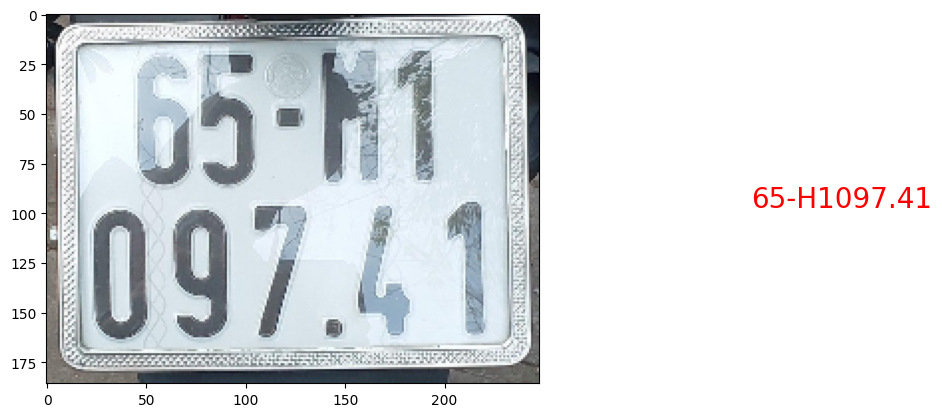

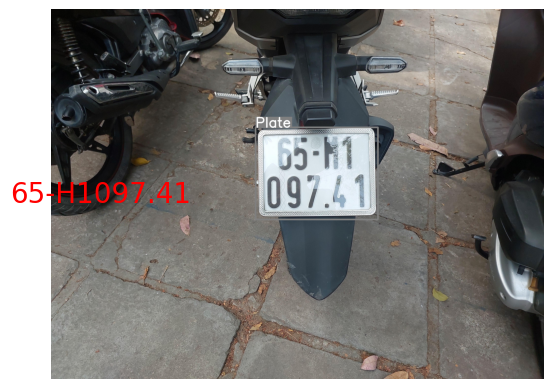

Time system: 3.0746753215789795
File name: 20240117_101401-1-_jpg.rf.1095ac271e3e450893d2dfebad44608e.jpg

image 1/1 /content/LPR-1/valid/images/20240117_101401-1-_jpg.rf.1095ac271e3e450893d2dfebad44608e.jpg: 384x640 1 Plate, 941.6ms
Speed: 4.9ms preprocess, 941.6ms inference, 0.4ms postprocess per image at shape (1, 3, 384, 640)
Time YOLO: 1.0213825702667236
Size: 925 665
[2025/02/20 15:25:08] ppocr WARNING: Since the angle classifier is not initialized, it will not be used during the forward process
Processing time: 0.26 seconds


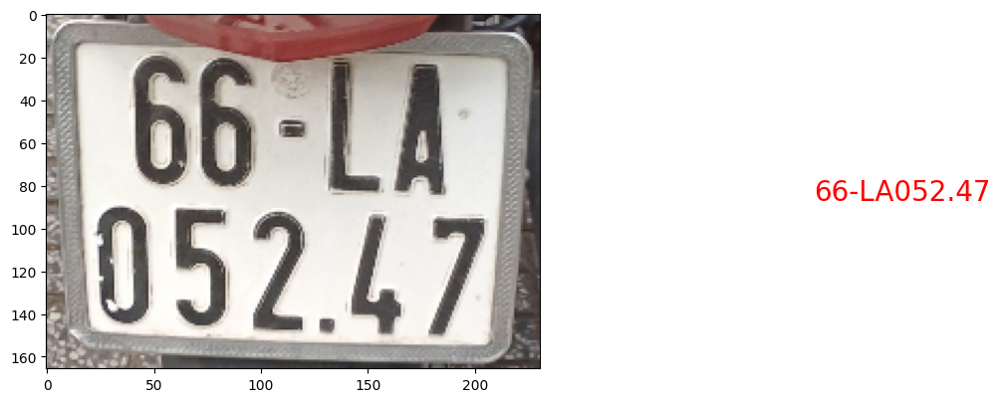

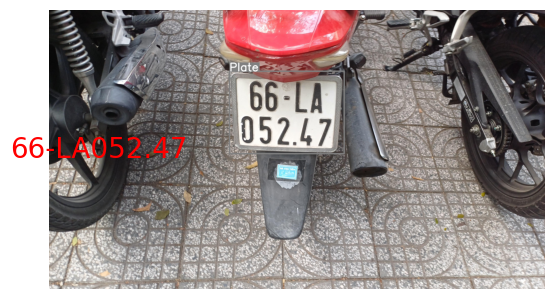

Time system: 2.421584129333496
File name: 20240117_101453_jpg.rf.473c5efdeb4dd1aaf3fc66800a436bec.jpg

image 1/1 /content/LPR-1/valid/images/20240117_101453_jpg.rf.473c5efdeb4dd1aaf3fc66800a436bec.jpg: 384x640 1 Plate, 902.0ms
Speed: 5.5ms preprocess, 902.0ms inference, 0.4ms postprocess per image at shape (1, 3, 384, 640)
Time YOLO: 0.9977469444274902
Size: 700 509
[2025/02/20 15:25:11] ppocr WARNING: Since the angle classifier is not initialized, it will not be used during the forward process
Processing time: 0.30 seconds


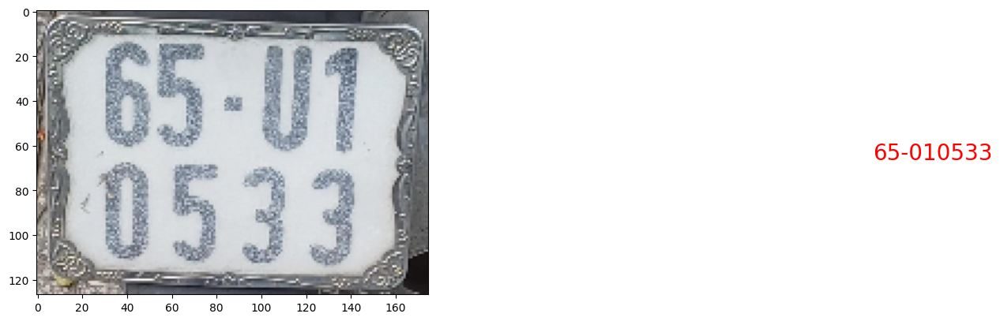

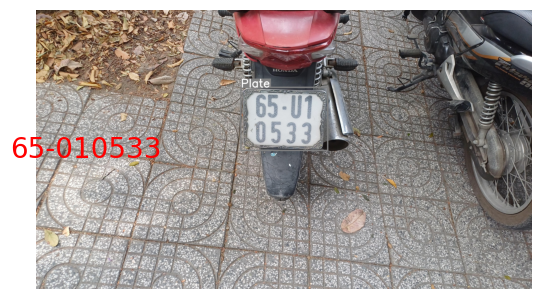

Time system: 2.458796501159668
File name: 20240117_101521_jpg.rf.b4e03362c45c5ae1c37f084aedd84bce.jpg

image 1/1 /content/LPR-1/valid/images/20240117_101521_jpg.rf.b4e03362c45c5ae1c37f084aedd84bce.jpg: 480x640 1 Plate, 1572.5ms
Speed: 6.3ms preprocess, 1572.5ms inference, 0.4ms postprocess per image at shape (1, 3, 480, 640)
Time YOLO: 1.723287582397461
Size: 969 707
[2025/02/20 15:25:14] ppocr WARNING: Since the angle classifier is not initialized, it will not be used during the forward process
Processing time: 0.27 seconds


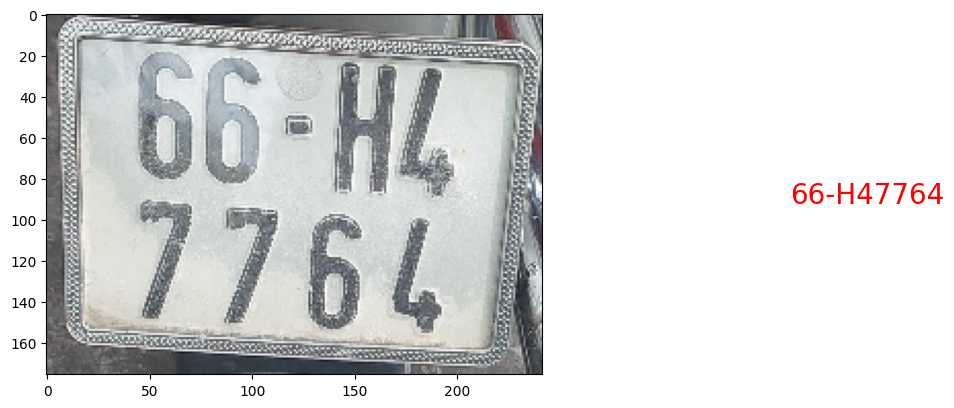

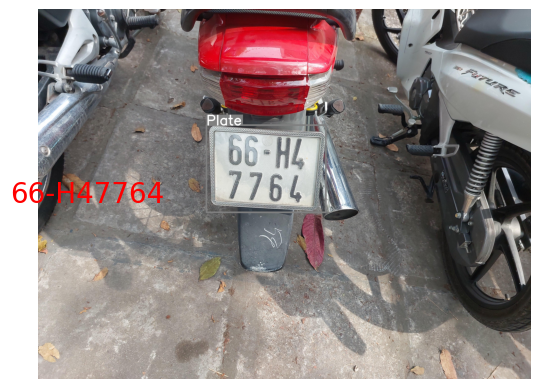

Time system: 4.069322347640991
File name: 20240117_101610_jpg.rf.c2c9721a3e9fc373fe5a7f0d8bfeec57.jpg

image 1/1 /content/LPR-1/valid/images/20240117_101610_jpg.rf.c2c9721a3e9fc373fe5a7f0d8bfeec57.jpg: 480x640 1 Plate, 1070.8ms
Speed: 6.1ms preprocess, 1070.8ms inference, 0.4ms postprocess per image at shape (1, 3, 480, 640)
Time YOLO: 1.224698781967163
Size: 866 671
[2025/02/20 15:25:18] ppocr WARNING: Since the angle classifier is not initialized, it will not be used during the forward process
Processing time: 0.25 seconds


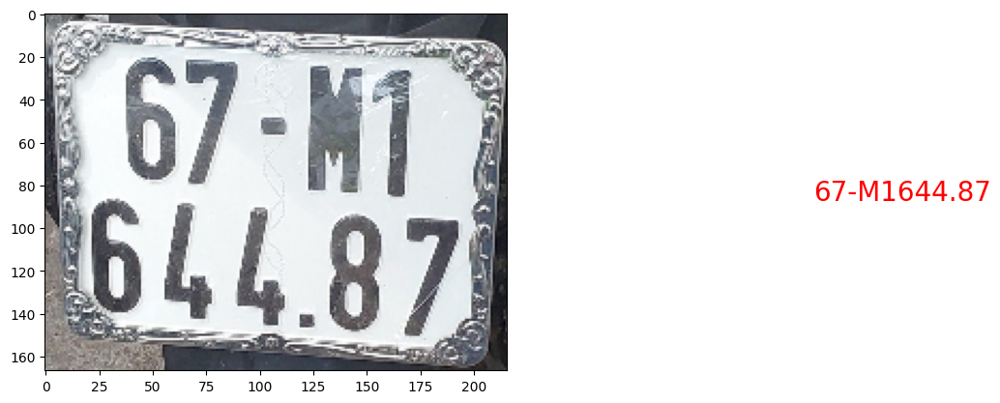

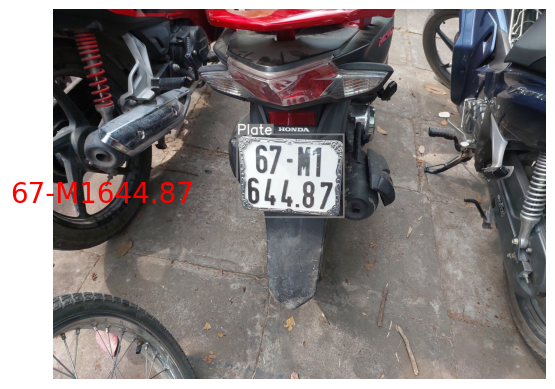

Time system: 2.9611685276031494
File name: 20240117_101612_jpg.rf.cb0d383524252b7f6f564994d8295410.jpg

image 1/1 /content/LPR-1/valid/images/20240117_101612_jpg.rf.cb0d383524252b7f6f564994d8295410.jpg: 480x640 1 Plate, 1082.5ms
Speed: 5.8ms preprocess, 1082.5ms inference, 0.3ms postprocess per image at shape (1, 3, 480, 640)
Time YOLO: 1.2291884422302246
Size: 1102 811
[2025/02/20 15:25:21] ppocr WARNING: Since the angle classifier is not initialized, it will not be used during the forward process
Processing time: 0.34 seconds


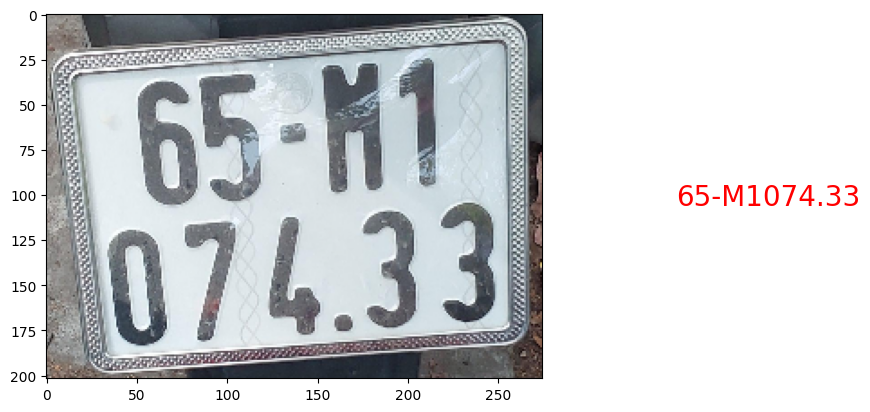

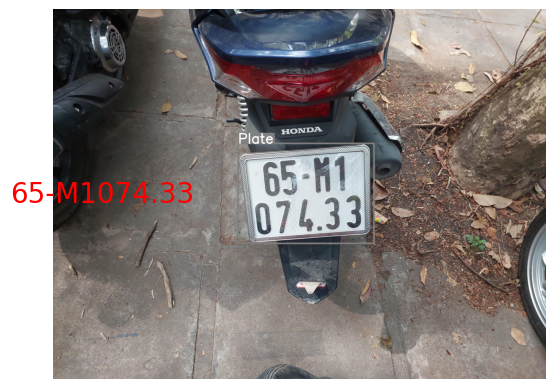

Time system: 3.0512218475341797
File name: 20240117_101705_jpg.rf.a4600b2db96527020224487f22bdf74c.jpg

image 1/1 /content/LPR-1/valid/images/20240117_101705_jpg.rf.a4600b2db96527020224487f22bdf74c.jpg: 480x640 1 Plate, 1070.2ms
Speed: 6.0ms preprocess, 1070.2ms inference, 0.4ms postprocess per image at shape (1, 3, 480, 640)
Time YOLO: 1.2063097953796387
Size: 920 660
[2025/02/20 15:25:24] ppocr WARNING: Since the angle classifier is not initialized, it will not be used during the forward process
Processing time: 0.22 seconds


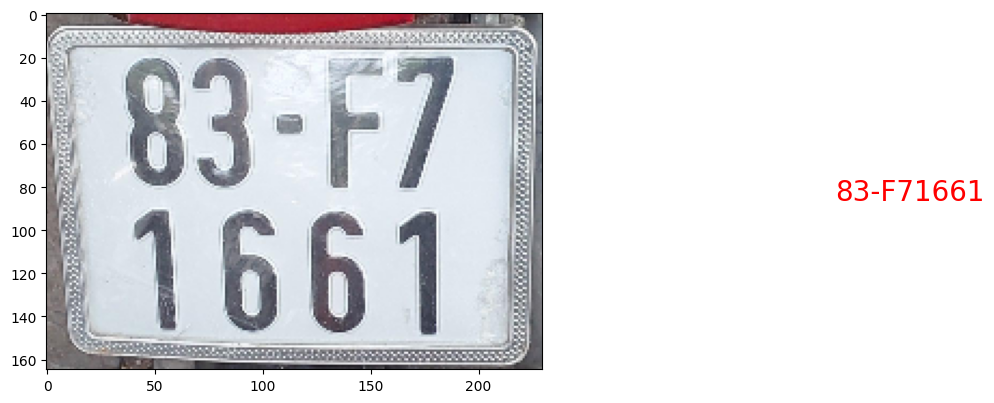

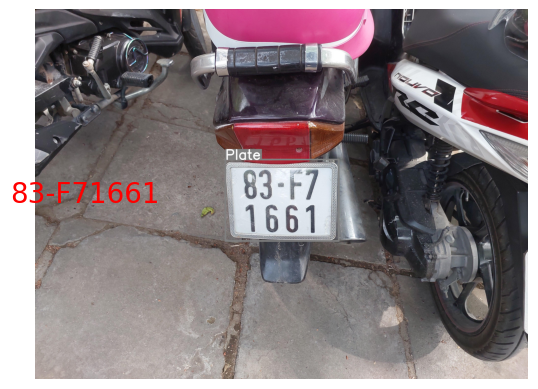

Time system: 3.0178279876708984
File name: 20240117_101803-1-_jpg.rf.9e47c1d61ee660dd25573f68f8eb2d74.jpg

image 1/1 /content/LPR-1/valid/images/20240117_101803-1-_jpg.rf.9e47c1d61ee660dd25573f68f8eb2d74.jpg: 384x640 1 Plate, 1282.2ms
Speed: 5.1ms preprocess, 1282.2ms inference, 0.4ms postprocess per image at shape (1, 3, 384, 640)
Time YOLO: 1.365081548690796
Size: 864 583
[2025/02/20 15:25:27] ppocr WARNING: Since the angle classifier is not initialized, it will not be used during the forward process
Processing time: 0.23 seconds


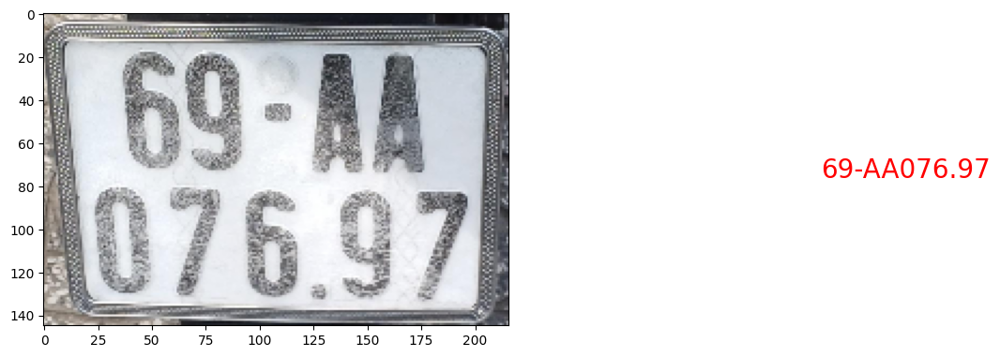

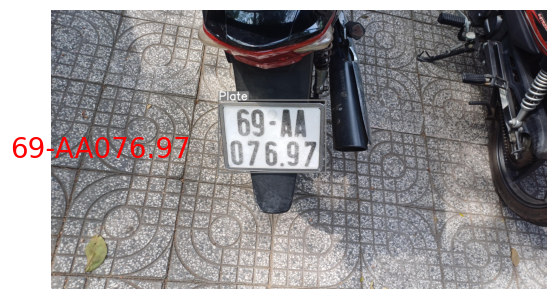

Time system: 3.248060941696167
File name: 20240117_103202-1-_jpg.rf.7a1c459987c10bcc6a3d5f66cc7d13a4.jpg

image 1/1 /content/LPR-1/valid/images/20240117_103202-1-_jpg.rf.7a1c459987c10bcc6a3d5f66cc7d13a4.jpg: 384x640 1 Plate, 1429.7ms
Speed: 5.4ms preprocess, 1429.7ms inference, 0.6ms postprocess per image at shape (1, 3, 384, 640)
Time YOLO: 1.5164222717285156
Size: 936 707
[2025/02/20 15:25:31] ppocr WARNING: Since the angle classifier is not initialized, it will not be used during the forward process
Processing time: 0.31 seconds


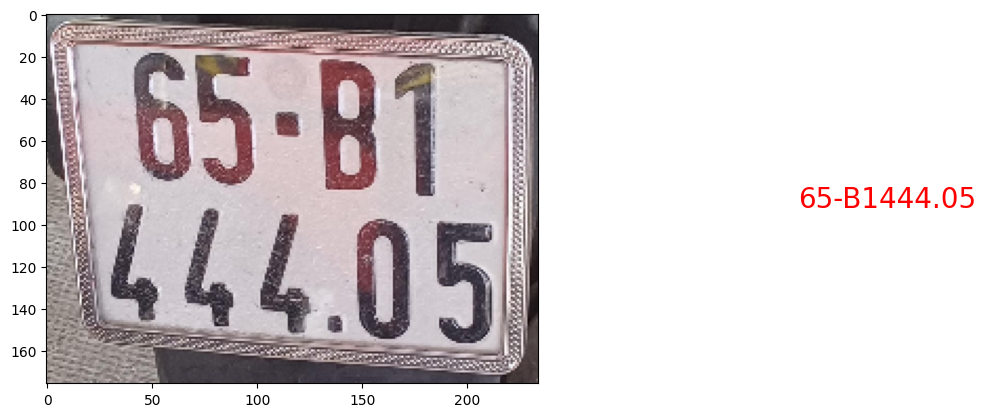

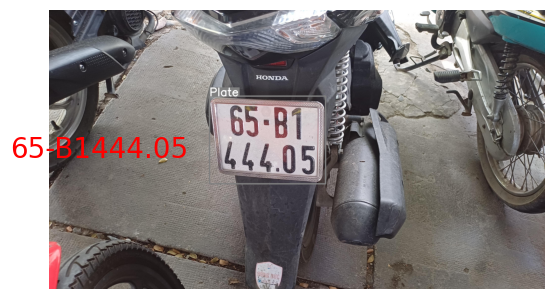

Time system: 3.1218318939208984
File name: IMG_20240114_100543_jpg.rf.b28799b009dcaaf223c4cf5509ef97c2.jpg

image 1/1 /content/LPR-1/valid/images/IMG_20240114_100543_jpg.rf.b28799b009dcaaf223c4cf5509ef97c2.jpg: 640x480 1 Plate, 1110.3ms
Speed: 6.1ms preprocess, 1110.3ms inference, 0.3ms postprocess per image at shape (1, 3, 640, 480)
Time YOLO: 1.2554657459259033
Size: 776 550
[2025/02/20 15:25:34] ppocr WARNING: Since the angle classifier is not initialized, it will not be used during the forward process
Processing time: 0.23 seconds


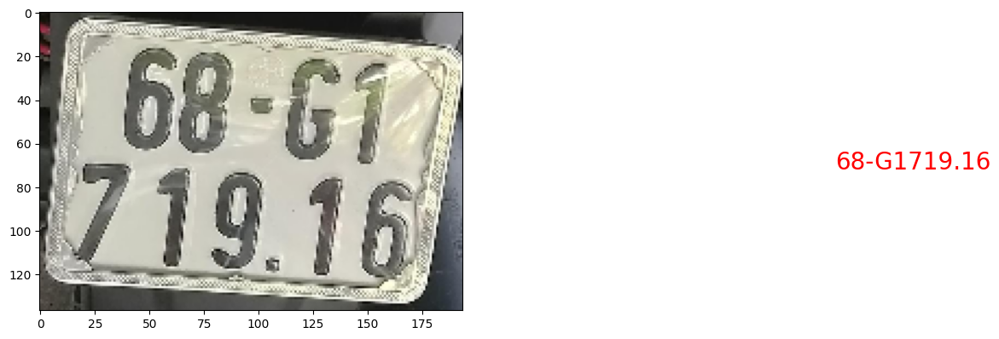

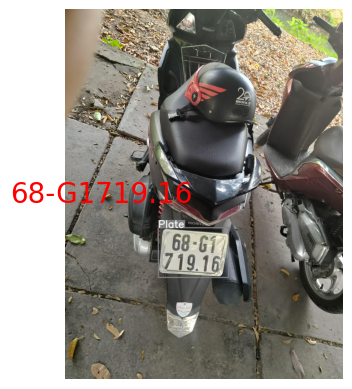

Time system: 3.082430601119995
File name: IMG_20240114_100050_jpg.rf.fbbc304580631ddd207b26c8fe9b2353.jpg

image 1/1 /content/LPR-1/valid/images/IMG_20240114_100050_jpg.rf.fbbc304580631ddd207b26c8fe9b2353.jpg: 640x480 1 Plate, 1139.7ms
Speed: 5.8ms preprocess, 1139.7ms inference, 0.3ms postprocess per image at shape (1, 3, 640, 480)
Time YOLO: 1.303835391998291
Size: 969 775
[2025/02/20 15:25:37] ppocr WARNING: Since the angle classifier is not initialized, it will not be used during the forward process
Processing time: 0.24 seconds


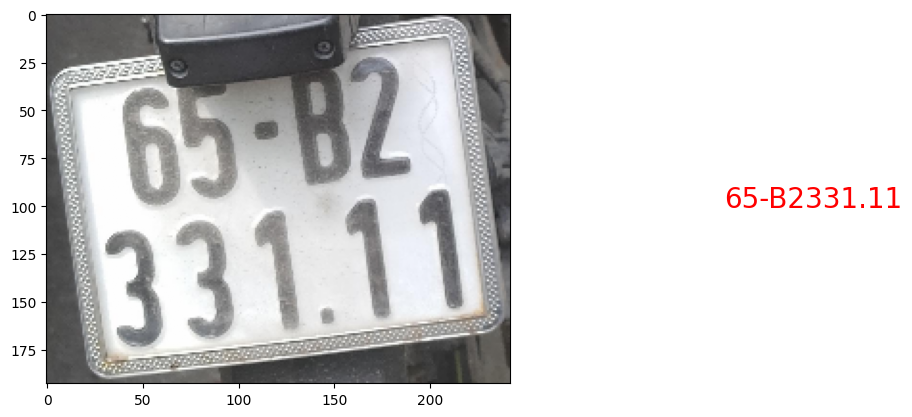

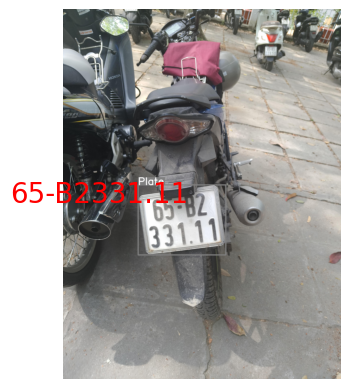

Time system: 3.6090009212493896
File name: IMG_20240114_100200_jpg.rf.28c30ee1102fbfa31dee48e1ad083ad1.jpg

image 1/1 /content/LPR-1/valid/images/IMG_20240114_100200_jpg.rf.28c30ee1102fbfa31dee48e1ad083ad1.jpg: 640x480 1 Plate, 1143.1ms
Speed: 6.5ms preprocess, 1143.1ms inference, 0.4ms postprocess per image at shape (1, 3, 640, 480)
Time YOLO: 1.2667038440704346
Size: 412 344
[2025/02/20 15:25:41] ppocr WARNING: Since the angle classifier is not initialized, it will not be used during the forward process
Processing time: 0.25 seconds


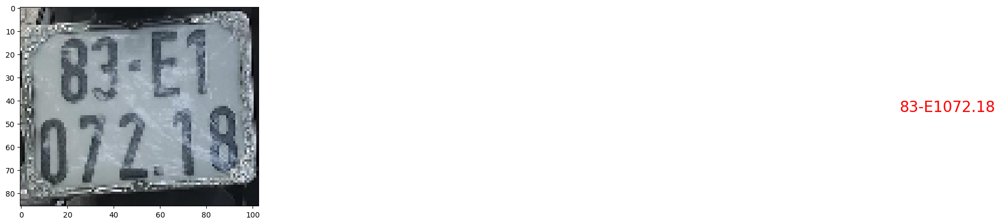

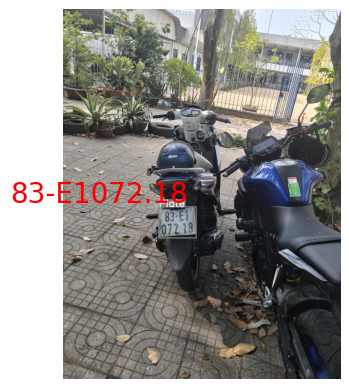

Time system: 3.3586602210998535
File name: IMG_20240115_125641_jpg.rf.dca4bfcf6438c1aa773a5ab75cec9f2d.jpg

image 1/1 /content/LPR-1/valid/images/IMG_20240115_125641_jpg.rf.dca4bfcf6438c1aa773a5ab75cec9f2d.jpg: 640x480 1 Plate, 1612.0ms
Speed: 6.0ms preprocess, 1612.0ms inference, 0.4ms postprocess per image at shape (1, 3, 640, 480)
Time YOLO: 1.7327604293823242
Size: 736 551
[2025/02/20 15:25:45] ppocr WARNING: Since the angle classifier is not initialized, it will not be used during the forward process
Processing time: 0.29 seconds


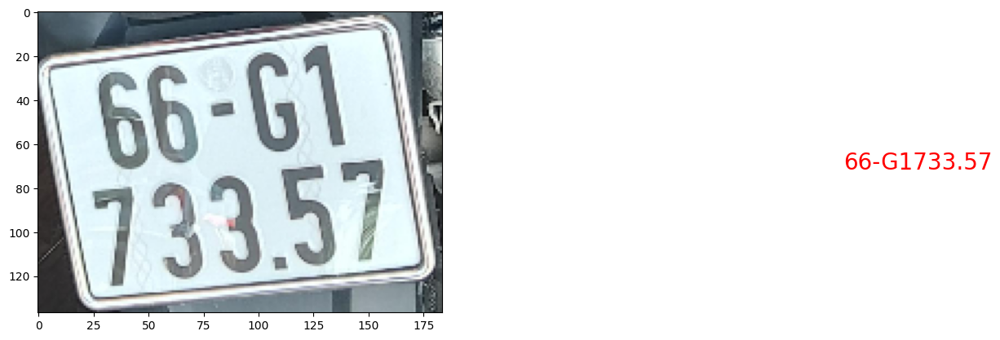

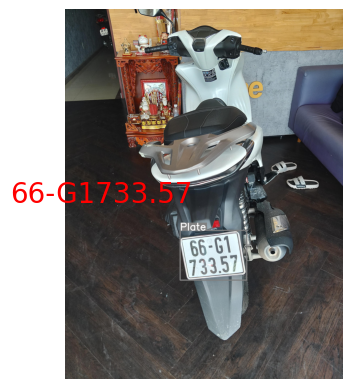

Time system: 3.8894402980804443
File name: IMG_20240114_100449_jpg.rf.160ceafe437b7b04dcfde01ed8a42a62.jpg

image 1/1 /content/LPR-1/valid/images/IMG_20240114_100449_jpg.rf.160ceafe437b7b04dcfde01ed8a42a62.jpg: 640x480 1 Plate, 1147.9ms
Speed: 6.2ms preprocess, 1147.9ms inference, 0.4ms postprocess per image at shape (1, 3, 640, 480)
Time YOLO: 1.2572007179260254
Size: 646 483
[2025/02/20 15:25:48] ppocr WARNING: Since the angle classifier is not initialized, it will not be used during the forward process
Processing time: 0.26 seconds


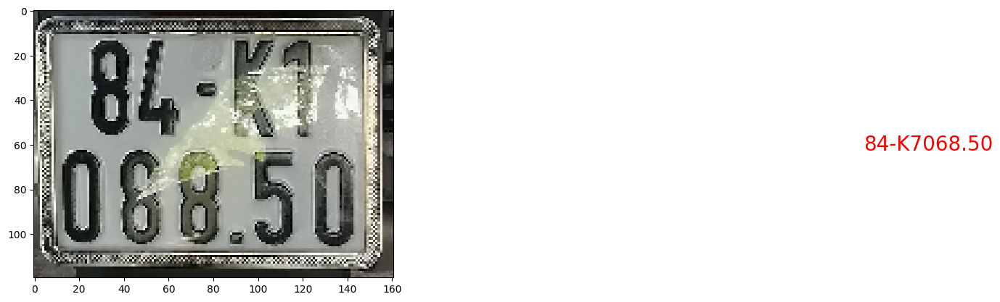

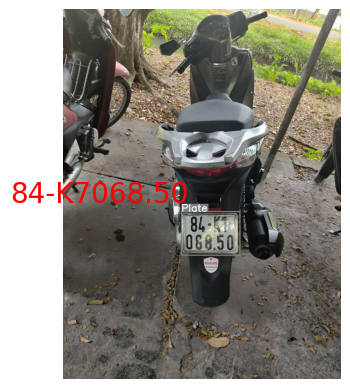

Time system: 3.0367228984832764
File name: IMG_20240114_100645_jpg.rf.edf2b3dfe173949e6897e12e6381610a.jpg

image 1/1 /content/LPR-1/valid/images/IMG_20240114_100645_jpg.rf.edf2b3dfe173949e6897e12e6381610a.jpg: 640x480 1 Plate, 1153.3ms
Speed: 7.0ms preprocess, 1153.3ms inference, 0.4ms postprocess per image at shape (1, 3, 640, 480)
Time YOLO: 1.2900574207305908
Size: 796 534
[2025/02/20 15:25:51] ppocr WARNING: Since the angle classifier is not initialized, it will not be used during the forward process
Processing time: 0.24 seconds


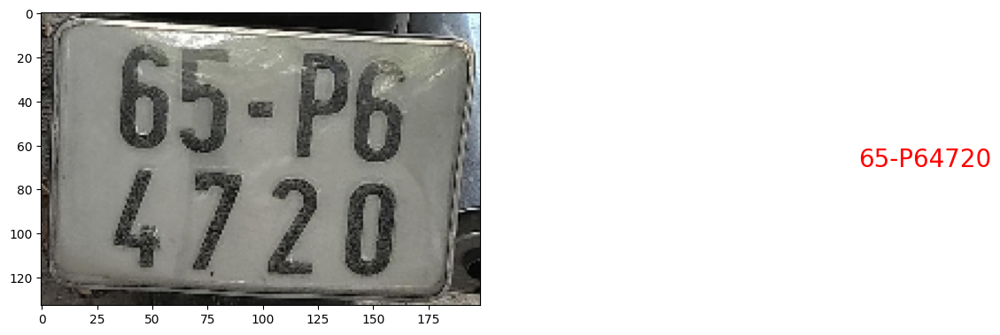

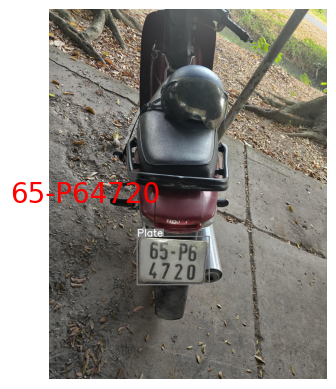

Time system: 3.1065404415130615
File name: IMG_20240117_153110_jpg.rf.2faffb317f88c9b0f40ca86ed94bdfd6.jpg

image 1/1 /content/LPR-1/valid/images/IMG_20240117_153110_jpg.rf.2faffb317f88c9b0f40ca86ed94bdfd6.jpg: 640x480 1 Plate, 1153.5ms
Speed: 6.2ms preprocess, 1153.5ms inference, 0.3ms postprocess per image at shape (1, 3, 640, 480)
Time YOLO: 1.275345802307129
Size: 799 580
[2025/02/20 15:25:54] ppocr WARNING: Since the angle classifier is not initialized, it will not be used during the forward process
Processing time: 0.30 seconds


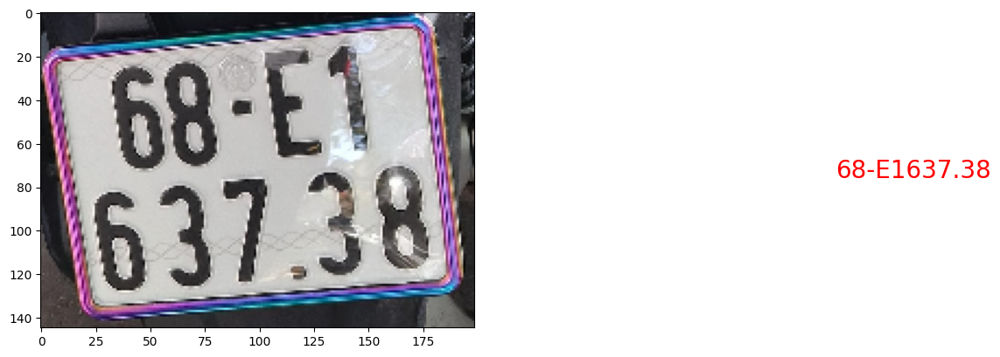

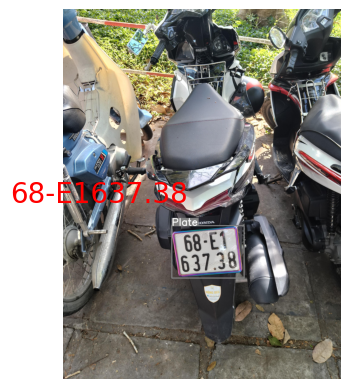

Time system: 3.3979456424713135
File name: IMG_20240117_153045_jpg.rf.12a729a231c890277767b38641fa6807.jpg

image 1/1 /content/LPR-1/valid/images/IMG_20240117_153045_jpg.rf.12a729a231c890277767b38641fa6807.jpg: 640x480 1 Plate, 1635.4ms
Speed: 5.7ms preprocess, 1635.4ms inference, 0.4ms postprocess per image at shape (1, 3, 640, 480)
Time YOLO: 1.7689688205718994
Size: 812 599
[2025/02/20 15:25:58] ppocr WARNING: Since the angle classifier is not initialized, it will not be used during the forward process
Processing time: 0.27 seconds


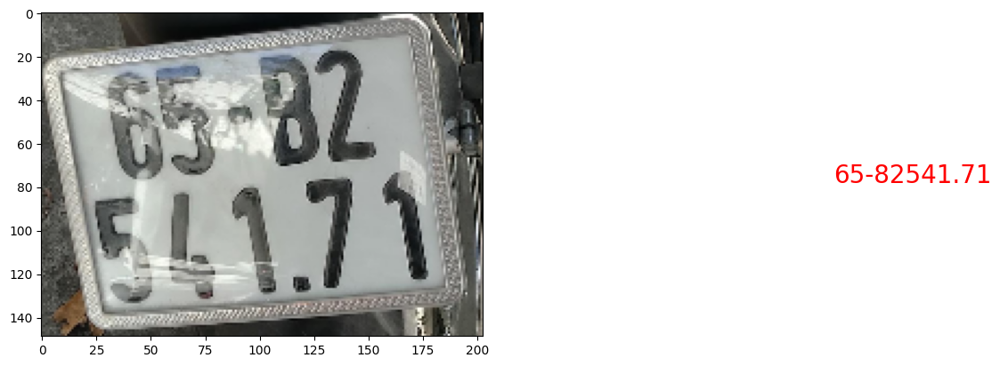

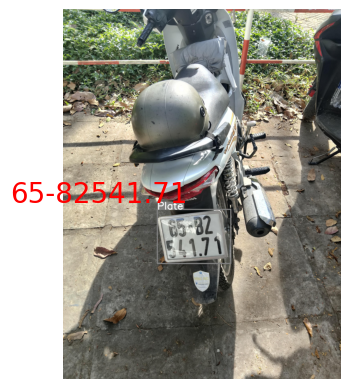

Time system: 4.072293519973755
File name: IMG_20240117_152949_jpg.rf.dc94f3bd1c1346dc7ab3467e4075b27c.jpg

image 1/1 /content/LPR-1/valid/images/IMG_20240117_152949_jpg.rf.dc94f3bd1c1346dc7ab3467e4075b27c.jpg: 640x480 1 Plate, 1221.9ms
Speed: 6.4ms preprocess, 1221.9ms inference, 0.4ms postprocess per image at shape (1, 3, 640, 480)
Time YOLO: 1.3341617584228516
Size: 883 651
[2025/02/20 15:26:02] ppocr WARNING: Since the angle classifier is not initialized, it will not be used during the forward process
Processing time: 0.23 seconds


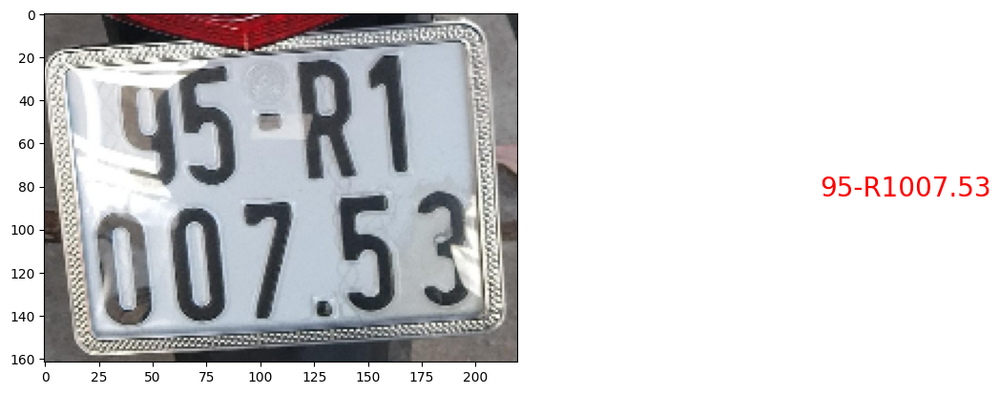

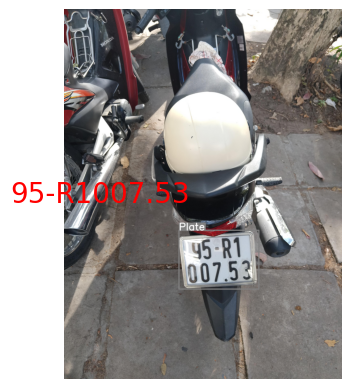

Time system: 3.268768787384033


In [64]:
from ultralytics.utils.plotting import Annotator  # ultralytics.yolo.utils.plotting is deprecated
import cv2
from google.colab.patches import cv2_imshow
import time
import matplotlib.pyplot as plt

# Khởi tạo biến tính độ chính xác
accuracy = 0

# Duyệt qua tất cả các file trong map
for file in map:
    # Đường dẫn ảnh
    img_path = f"/content/LPR-1/valid/images/{file}"
    print('File name:', file)

    # Đọc ảnh và khởi tạo thời gian
    img = cv2.imread(img_path)
    t1 = time.time()

    # Dự đoán bounding box bằng YOLO
    tx = time.time()
    results = model.predict(img_path, device="cpu")
    ty = time.time()
    print("Time YOLO:", ty - tx)

    crop_rgb_image = None

    # Duyệt qua tất cả các kết quả
    for r in results:
        annotator = Annotator(img)
        boxes = r.boxes

        # Duyệt qua từng bounding box
        for box in boxes:
            # Lấy tọa độ bounding box
            x1, y1, x2, y2 = box.xyxy[0]

            crop_rgb_image = img[int(y1):int(y2), int(x1):int(x2)]
            h, w = crop_rgb_image.shape[:2]
            print("Size:", w, h)

            # Resize ảnh để OCR tốt hơn
            crop_rgb_image = cv2.resize(crop_rgb_image, (int(w/4), int(h/4)))
            cv2.imwrite("crop.png", crop_rgb_image)

            # Dự đoán biển số bằng PaddleOCR
            result = paddle_predict("crop.png", ocr)

            # Tính độ chính xác bằng Levenshtein accuracy
            accuracy += levenshtein_accuracy(result, map[file])

            # Hiển thị nhãn trên ảnh gốc
            c = box.cls
            plt.text(400, img.shape[0] / 2, result, fontsize=20, color='red', ha='center', va='center')
            annotator.box_label([x1, y1, x2, y2], model.names[int(c)])

    # Hiển thị ảnh với bounding box và nhãn
    plt.imshow(cv2.cvtColor(img, cv2.COLOR_BGR2RGB))
    plt.axis("off")  # Ẩn trục tọa độ
    plt.show()

    # Tính thời gian xử lý hệ thống
    t2 = time.time()
    print("Time system:", t2 - t1)

# Tính toán độ chính xác trung bình
accuracy /= len(map)



In [65]:
print(f"Accuracy of License plate recognition: {accuracy*100:.2f}%")

Accuracy of License plate recognition: 98.36%


### Predict each images

Image shape: (3000, 4000, 3)

image 1/1 /content/LPR-1/valid/images/20240117_101408_jpg.rf.185bf3b66866cc57ca34d2a24e536215.jpg: 480x640 1 Plate, 1034.7ms
Speed: 4.2ms preprocess, 1034.7ms inference, 0.4ms postprocess per image at shape (1, 3, 480, 640)
Cropped size: 993 747
[2025/02/20 15:27:20] ppocr WARNING: Since the angle classifier is not initialized, it will not be used during the forward process
Processing time: 0.17 seconds


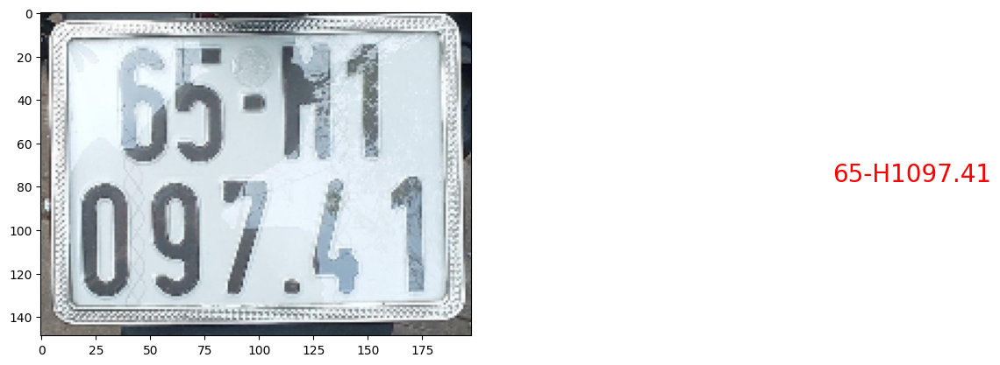

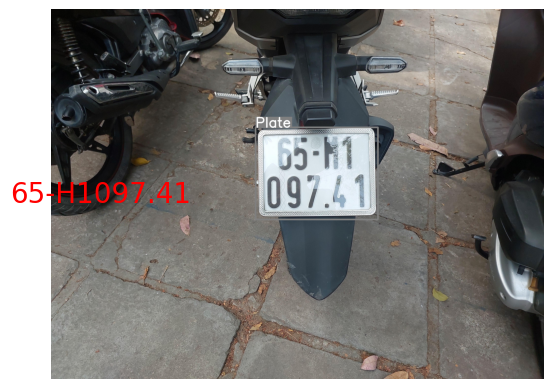

Processing time: 1.4497489929199219


In [66]:
from ultralytics.utils.plotting import Annotator  # ultralytics.yolo.utils.plotting is deprecated
import cv2
import time
import matplotlib.pyplot as plt

# Đường dẫn ảnh
img_path = "/content/LPR-1/valid/images/20240117_101408_jpg.rf.185bf3b66866cc57ca34d2a24e536215.jpg"

# Đọc ảnh
img = cv2.imread(img_path)
print("Image shape:", img.shape)

# Dự đoán bounding box bằng YOLO
results = model.predict(img_path, device="cpu")

# Khởi tạo Annotator cho việc vẽ box và nhãn
annotator = Annotator(img)
crop_rgb_image = None
start_time = time.time()

# Duyệt qua tất cả các kết quả
for r in results:
    boxes = r.boxes

    # Duyệt qua từng bounding box
    for box in boxes:
        # Lấy tọa độ bounding box
        x1, y1, x2, y2 = box.xyxy[0]

        # Cắt ảnh từ bounding box
        crop_rgb_image = img[int(y1):int(y2), int(x1):int(x2)]
        h, w = crop_rgb_image.shape[:2]
        print("Cropped size:", w, h)

        # Resize ảnh để OCR tốt hơn
        crop_rgb_image = cv2.resize(crop_rgb_image, (int(w / 5), int(h / 5)))
        cv2.imwrite("crop.png", crop_rgb_image)

        # Dự đoán biển số bằng PaddleOCR
        result = paddle_predict("crop.png", ocr)

        # Hiển thị nhãn trên ảnh gốc
        plt.text(400, img.shape[0] / 2, result, fontsize=20, color='red', ha='center', va='center')
        annotator.box_label([x1, y1, x2, y2], model.names[int(box.cls)])

# Hiển thị ảnh với bounding box và nhãn
plt.imshow(cv2.cvtColor(img, cv2.COLOR_BGR2RGB))
plt.axis("off")  # Ẩn trục tọa độ
plt.show()

# Tính thời gian xử lý
end_time = time.time()
print("Processing time:", end_time - start_time)
